# Match visibility with solar PV production per panel

In [1]:
# Import pickle package
import pickle
import pandas as pd
import numpy as np

In [2]:
import os

In [3]:
# Choose the ground patch subdivision (tile) to be used among the several
tile=3897

In [4]:
# Set directory
directory="E:/SwitchDrive/Solviz/"
#directory = "/Users/giuseppeperonato/switchdrive/SolViz"

## Import production data and index them by EGID and panels

In [5]:
# read pickled file with production details per panel
production=pd.read_pickle(os.path.join(directory,"Simulation/geneva/PV/WHOLE ENVELOPE/geneva_{}_opaque_grid130x88_LOD23_DC.p".format(tile)),compression='gzip')
viscatext=os.path.join(directory,"Simulation/geneva/visual amplitude/withtrees50%/TXT/tile{}.txt".format(tile))
rooftfcsv=os.path.join(directory,"Simulation/geneva/CSV/panels/tile{}.csv".format(tile))
production.head()

,0,1,2,3,4,5,6,7,8,9,...,26024,26025,26026,26027,26028,26029,26030,26031,26032,26033
datetime,,,,,,,,,,,,,,,,,,,,,
2005-01-01 00:05:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2005-01-01 01:05:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2005-01-01 02:05:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2005-01-01 03:05:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2005-01-01 04:05:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### Here we import the panel geometry and indexes

In [6]:
# read panel details table which maps where each panel is on buildings surfaces
pantab=pd.read_csv(os.path.join(directory,'Simulation/geneva/CSV/panels/tile{}.csv'.format(tile)),delimiter=';')
pantab.head()
#pantab.shape

,BLDGID,SRFID,ROWID,PANELID,PANELCOORDINATES,ROOF T/F
0,1013643,0,2,0,-20.215867 31.742712 429.776565 -20.758787 30....,True
1,1013643,0,2,1,-20.942841 32.076031 429.421584 -21.485762 30....,True
2,1013643,0,3,0,-20.758788 30.561514 429.779342 -21.301708 29....,True
3,1013643,0,3,1,-21.485764 30.894833 429.4243 -22.028684 29.71...,True
4,1013643,1,1,0,-19.10557 28.377467 429.602967 -18.562648 29.5...,True


In [7]:
# extract arrays of BLDGID SRFID ROWID PANELID
multindex=np.array([np.array(pantab['BLDGID']),np.array(pantab['SRFID']),np.array(pantab['ROWID']),np.array(pantab['PANELID'])])
multituples=list(zip(*multindex))

In [8]:
# count the number of panels per each building
counts_dict={}
for entry in pantab['BLDGID']:
        if entry in counts_dict.keys():
            counts_dict[entry] += 1
        else:
            counts_dict[entry] = 1
panperbu=pd.DataFrame.from_records(data=counts_dict,index=[0])

### Creation of the final Production table 'product' with 8760 hours/year as rows and the indexed panels as columns

In [9]:
# create a dictionary containing the the panel index ID as key and the corresponding building EGID code on which it is installed as value
panbudict={}
for entry in pantab.index:
    panbudict[entry]=pantab['BLDGID'][entry]
panbudict

# create a multi-index table with building EGID code as 1st level index, surface ID as 2nd level index, row ID as 3rd, panel ID as 4th
product=production.copy()
product.columns = pd.MultiIndex.from_tuples(multituples)

# create a multi-index table with building EGID code as 1st level index and panel index ID as 2nd level index
#product.columns = pd.MultiIndex.from_tuples([*zip(map(panbudict.get, product), product)])
product

1013643                               ... 295145534        \
                            0           1     2  3        ...         1     2   
                            2     3     1  2  0  1        ...         4     1   
                            0  1  0  1  0  0  0  0  1  2  ...         4  5  0   
datetime                                                  ...                   
2005-01-01 00:05:00         0  0  0  0  0  0  0  0  0  0  ...         0  0  0   
2005-01-01 01:05:00         0  0  0  0  0  0  0  0  0  0  ...         0  0  0   
2005-01-01 02:05:00         0  0  0  0  0  0  0  0  0  0  ...         0  0  0   
2005-01-01 03:05:00         0  0  0  0  0  0  0  0  0  0  ...         0  0  0   
2005-01-01 04:05:00         0  0  0  0  0  0  0  0  0  0  ...         0  0  0   
...                       ... .. .. .. .. .. .. .. .. ..  ...       ... .. ..   
2005-12-31 19:05:00         0  0  0  0  0  0  0  0  0  0  ...         0  0  0   
2005-12-31 20:05:00         0  0  0  0  0  0  0  0  0  0  ...         0  0  0   
2005-12-31 21:05:00         0  0  0  0  0  0  0  0  0  0  ...         0  0  0   
2005-12-31 22:05:00         0  0  0  0  0  0  0  0  0  0  ...         0  0  0   
2005-12-31 23:05:00         0  0  0  0  0  0  0  0  0  0  ...         0  0  0   

                                          
                              4           
                     2  3  4  1  2  3  4  
                     0  0  0  0  0  0  0  
datetime                                  
2005-01-01 00:05:00  0  0  0  0  0  0  0  
2005-01-01 01:05:00  0  0  0  0  0  0  0  
2005-01-01 02:05:00  0  0  0  0  0  0  0  
2005-01-01 03:05:00  0  0  0  0  0  0  0  
2005-01-01 04:05:00  0  0  0  0  0  0  0  
...                 .. .. .. .. .. .. ..  
2005-12-31 19:05:00  0  0  0  0  0  0  0  
2005-12-31 20:05:00  0  0  0  0  0  0  0  
2005-12-31 21:05:00  0  0  0  0  0  0  0  
2005-12-31 22:05:00  0  0  0  0  0  0  0  
2005-12-31 23:05:00  0  0  0  0  0  0  0  

[8760 rows x 26034 columns]

## Import visibility data and index them by EGID and panels

In [10]:
# Create the dictionary with tree branches as indexes and values as floats in a list
with open(viscatext, "r") as f:
    headerlist=[]
    dictio={}
    for x,n in enumerate(f):
        if '{' in n:
            headerlist.append(n[n.find('{')+1:n.find('}')])
            dictio[n[n.find('{')+1:n.find('}')]]=[]
        else:
            dictio[headerlist[-1]].append(float(n[n.find(' ')+1:n.find('\n')])) # get rid of float fuct in case it's another type           

here we handle multiple values per panel due to triangulation of quadrangular panels

In [11]:
# If values in branch (triangles in panels) are all equal, keep the value of the branch, otherwise keep the max
avgviscat = {}
for k,v in dictio.items():
    mean=sum(v)/ float(len(v))# v is the list of cat for panel k
    if mean.is_integer()==True:
        avgviscat[k] = mean
    else:
        avgviscat[k] = mean

### Creation of the final visibility table 'panmatrix' with indexed panels as rows and Visual Amplitude index as column + flag whether the panel is on a roof (almost vertical normal) or on a facade (horizontal normal)

In [12]:
# Create and Format DataFrame "viscat" with multi-index
viscat=pd.DataFrame(avgviscat,index=[0])
viscat=viscat.T
rooftf=pd.read_csv(rooftfcsv,delimiter=';')
rooftf.index=pd.MultiIndex.from_arrays([np.array(rooftf['BLDGID']),np.array(rooftf['SRFID']),np.array(rooftf['ROWID']),np.array(rooftf['PANELID'])])

viscat.columns=['AV']
tuplot=[]
for x in viscat.index.str.split(pat=';'):
    tuplint=[]
    for el in x:
        tuplint.append(int(el))
    tuplot.append(tuple(tuplint))

viscat.index=pd.MultiIndex.from_tuples(tuplot)
panmatrix=pd.concat([viscat,rooftf[['ROOF T/F']]],axis=1)
panmatrix

AV  ROOF T/F
1013643   0 2 0  0.800298      True
              1  0.800432      True
            3 0  0.803987      True
              1  0.804112      True
          1 1 0  1.034426      True
...                   ...       ...
295145534 2 4 0  1.463809     False
          4 1 0  1.457983     False
            2 0  1.335920     False
            3 0  1.317045     False
            4 0  1.305953     False

[26034 rows x 2 columns]

## Matching loop to place PV panels at given visibility criteria

In [13]:
# these are the ranges that define the boundary visual amplitude values for the visibility classes:
lowvisbounds=[-10,0.0001]
medvisbounds=[0.0001,1.40]
highvisbounds=[1.40,3.95]

pattern=[1,1,0] #pattern on the façade (1 for panel, 0 for hole)
minfacpanels=2 #this is the minumum number of consecutive panels accepted on a facade in medium visibility
minfacpanels_low=2 #this is the minimum number of consecutive panels accepted on a facade in low visibility
minroofpanels=4 #this is the minimum number of consecutive panels accepted on a roof in medium visibility
#there are no minimum values for highvisibility (because no panel is allowed there)

#loop creation (requires some minutes)
patdf=panmatrix['AV'].unstack(level=-1).copy()
counter=0
for index,row in panmatrix['AV'].unstack(level=-1).iterrows():
    counter+=1
    numberofnan=len(row)-len(row.dropna(axis=0))
    if  panmatrix['ROOF T/F'].unstack(level=-1).mean(axis=1).loc[index]==False: # panel is on facade
        if medvisbounds[0] <= row.dropna(axis=0).mean()< medvisbounds[1]: # average row is in medium visibility range
            if len(row.dropna(axis=0))>=minfacpanels: # number of panels in row exceeds minimum
                quotient = len(row.dropna(axis=0)) // len(pattern)
                remainder = len(row.dropna(axis=0)) % len(pattern)
                patdf.loc[index]=np.array(pattern*quotient+pattern[0:remainder]+[np.nan]*numberofnan)
            else:
                patdf.loc[index]=np.array([0]*len(row.dropna(axis=0))+[np.nan]*numberofnan)
        elif lowvisbounds[0] <= row.dropna(axis=0).mean()< lowvisbounds[1]: # average row is in low visibility range
            if len(row.dropna(axis=0))>=minfacpanels_low: # number of panels in row exceeds minimum
                quotient = len(row.dropna(axis=0)) // len(pattern)
                remainder = len(row.dropna(axis=0)) % len(pattern)
                patdf.loc[index]=np.array(pattern*quotient+pattern[0:remainder]+[np.nan]*numberofnan)
            else:
                patdf.loc[index]=np.array([0]*len(row.dropna(axis=0))+[np.nan]*numberofnan)
        else: # average row is in high visibility range or out of any range
            patdf.loc[index]=np.array([0]*len(row.dropna(axis=0))+[np.nan]*numberofnan)
    elif panmatrix['ROOF T/F'].unstack(level=-1).mean(axis=1).loc[index]==True: # panel is on roof
        if medvisbounds[0] <= row.dropna(axis=0).mean()< medvisbounds[1]: # average row is in medium visibility range
            if len(row.dropna(axis=0))>=minroofpanels: # number of panels in row exceeds minimum
                patdf.loc[index]=np.array([1]*len(row.dropna(axis=0))+[np.nan]*numberofnan)
            else:
                patdf.loc[index]=np.array([0]*len(row.dropna(axis=0))+[np.nan]*numberofnan)
        elif lowvisbounds[0] <= row.dropna(axis=0).mean()< lowvisbounds[1]: # average row is in low visibility range
            patdf.loc[index]=np.array([1]*len(row.dropna(axis=0))+[np.nan]*numberofnan)
        else: # average row is in high visibility range or out of any range
            patdf.loc[index]=np.array([0]*len(row.dropna(axis=0))+[np.nan]*numberofnan)
    print ('\r'+str(round(counter/len(patdf)*100,2))+' % complete', end='')
patdef=patdf.stack().to_frame()
patdef.T

100.0 % complete

1013643                                                 ... 295145534       \
          0                   1         2    3            ...         1        
          2         3         1    2    0    1            ...         4        
          0    1    0    1    0    0    0    0    1    2  ...         4    5   
0       0.0  0.0  0.0  0.0  0.0  0.0  1.0  1.0  1.0  1.0  ...       0.0  0.0   

                                           
     2                   4                 
     1    2    3    4    1    2    3    4  
     0    0    0    0    0    0    0    0  
0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  

[1 rows x 26034 columns]

In [14]:
patdef.iloc[:,:] = 1
patdef

0
1013643   0 2 0  1.0
              1  1.0
            3 0  1.0
              1  1.0
          1 1 0  1.0
...              ...
295145534 2 4 0  1.0
          4 1 0  1.0
            2 0  1.0
            3 0  1.0
            4 0  1.0

[26034 rows x 1 columns]

### Creation of the final weighted production table 'product_w' which includes only panels in the match

In [15]:
# first multiplication of panels productions * visibility coefficient matrix
product_w=product.mul(np.array(patdef.T),axis=1)
#product_w

#### Table 'y': Aggregation per panel throughout the whole year before filtering viability

In [16]:
# aggregate annual production data per panel
y=product_w.sum(axis=0)
y=y.to_frame(name='annualprod')
y.head()

annualprod
1013643 0 2 0    196891.0
            1    196891.0
          3 0    196891.0
            1    196891.0
        1 1 0    215283.0

#### Filtering out unviable panels

In [17]:
# delete panels with too low production (unrentable)
AC_rent_lim=120000 # Wh/year value of minimum rentability in Alternate Current
inverter_eff=0.85 # inverter efficiency

#Vectorized version
patdef.loc[y.annualprod < AC_rent_lim/inverter_eff] = 0

In [18]:
#final matrix multiplication
product_w=product.mul(np.array(patdef.T),axis=1)
product_w

1013643                                                 \
                            0                   1         2    3             
                            2         3         1    2    0    1             
                            0    1    0    1    0    0    0    0    1    2   
datetime                                                                     
2005-01-01 00:05:00       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2005-01-01 01:05:00       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2005-01-01 02:05:00       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2005-01-01 03:05:00       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2005-01-01 04:05:00       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
...                       ...  ...  ...  ...  ...  ...  ...  ...  ...  ...   
2005-12-31 19:05:00       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2005-12-31 20:05:00       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2005-12-31 21:05:00       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2005-12-31 22:05:00       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2005-12-31 23:05:00       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   

                     ... 295145534                                          \
                     ...         1         2                   4             
                     ...         4         1    2    3    4    1    2    3   
                     ...         4    5    0    0    0    0    0    0    0   
datetime             ...                                                     
2005-01-01 00:05:00  ...       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2005-01-01 01:05:00  ...       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2005-01-01 02:05:00  ...       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2005-01-01 03:05:00  ...       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2005-01-01 04:05:00  ...       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
...                  ...       ...  ...  ...  ...  ...  ...  ...  ...  ...   
2005-12-31 19:05:00  ...       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2005-12-31 20:05:00  ...       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2005-12-31 21:05:00  ...       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2005-12-31 22:05:00  ...       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2005-12-31 23:05:00  ...       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   

                          
                          
                       4  
                       0  
datetime                  
2005-01-01 00:05:00  0.0  
2005-01-01 01:05:00  0.0  
2005-01-01 02:05:00  0.0  
2005-01-01 03:05:00  0.0  
2005-01-01 04:05:00  0.0  
...                  ...  
2005-12-31 19:05:00  0.0  
2005-12-31 20:05:00  0.0  
2005-12-31 21:05:00  0.0  
2005-12-31 22:05:00  0.0  
2005-12-31 23:05:00  0.0  

[8760 rows x 26034 columns]

#### Final table 'z':  Aggregation per building EGID

In [19]:
# aggregate production data per building
z=product_w.sum(axis=1,level=0)
z

,1013643,1013645,1013646,1013647,1013648,1013649,1013650,1013653,1013654,1013656,...,295070089,295070360,295070361,295070371,295094700,295094760,295094763,295095712,295099788,295145534
datetime,,,,,,,,,,,,,,,,,,,,,
2005-01-01 00:05:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2005-01-01 01:05:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2005-01-01 02:05:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2005-01-01 03:05:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2005-01-01 04:05:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2005-12-31 19:05:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2005-12-31 20:05:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2005-12-31 21:05:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## Export

In [20]:
# set the export directory
export_dir='E:/'
#export_dir = "/Users/giuseppeperonato/switchdrive/SolViz/"

# export the aggregated result
z.to_csv(export_dir+'tile'+str(tile)+"_opaque_grid130x88_LOD23_DC_perbld.csv")

In [21]:
patdef.to_csv(export_dir+'tile'+str(tile)+'_opaque_grid130x88_LOD23_viscoeff.csv')

## Some plotting

In [22]:
import geopandas as gpd
import matplotlib.pyplot as plt

In [23]:
footprints = gpd.read_file(os.path.join(directory,"InputData","footprints","SHP","tile{}.shp".format(tile)))

In [24]:
footprints = pd.merge(footprints,(z.sum(axis=0).rename("z"))/1000000,left_on="EGID",right_index=True)

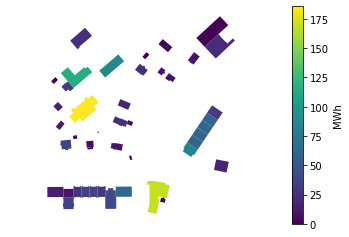

In [25]:
fig, ax = plt.subplots()
footprints.plot(column="z",legend=True,ax=ax, legend_kwds={'label': 'MWh'})
ax.set_axis_off()
plt.axis('equal')
plt.show()

## 3D

In [26]:
#Get the coordinates a numpy array, with each row [X1,Y1,Z1,X2,Y2,Z2,..X5,X5,Z5]
coordinates = pantab["PANELCOORDINATES"].str.split(" ",expand=True).apply(pd.to_numeric).to_numpy()

In [27]:
# Reshape the array in a [n*5,3]-array where n is the number of panels 
coordinates = coordinates.reshape(coordinates.shape[0]*(coordinates.shape[1]//3),3)

# over Z axis
coordinates[:,0] -= coordinates[coordinates[:,2]>0,2].min()
# To make sure that everying is above ground
coordinates[coordinates[:,2]<0,2] = 0

In [28]:
#Get the index of the i-vertex of the triangles
i = []
for k in range(coordinates.shape[0]//5):
    i.append(np.array([0,2])+5*k)
i = np.concatenate(i)

In [29]:
product_w_y = product_w.to_numpy().sum(axis=0)/1000

In [30]:
import plotly.graph_objects as go
import numpy as np

fig = go.Figure(data=[
    go.Mesh3d(
        x = coordinates[:,0],
        y = coordinates[:,1],
        z = coordinates[:,2],
        # Intensity of each triangle
        intensity = np.repeat(product_w_y,repeats=2),
        intensitymode='cell',
        colorscale=[[0, 'grey'],
                    [0.01, 'blue'],
                    [0.5, 'yellow'],
                    [1, 'red']],
        colorbar_title='kWh/module.year',
        # i, j and k give the vertices of triangles
        i = i,
        j = i+1,
        k = i+2,
        name='y',
        showscale=True
    )
])

fig.update_layout(
    scene_aspectmode="data",
    scene = dict(
        xaxis = dict(title="",showticklabels=False,ticks="",showbackground=False),
        yaxis = dict(title="",showticklabels=False,ticks="",showbackground=False),
        zaxis = dict(title="",showticklabels=False,ticks="",showbackground=False))
)



fig.show()